In [156]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import IsolationForest
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

%matplotlib inline

columns = ["duration",
           "protocol_type",
           "service",
           "flag",
           "src_bytes",
           "dst_bytes",
           "land",
           "wrong_fragment",
           "urgent",
           "hot",
           "num_failed_logins",
           "logged_in",
           "num_compromised",
           "root_shell",
           "su_attempted",
           "num_root",
           "num_file_creations",
           "num_shells",
           "num_access_files",
           "num_outbound_cmds",
           "is_host_login",
           "is_guest_login",
           "count",
           "srv_count",
           "serror_rate",
           "srv_serror_rate",
           "rerror_rate",
           "srv_rerror_rate",
           "same_srv_rate",
           "diff_srv_rate",
           "srv_diff_host_rate",
           "dst_host_count",
           "dst_host_srv_count",
           "dst_home_same_srv_rate",
           "dst_host_diff_srv_rate",
           "dst_host_same_src_port_rate",
           "dst_host_srv_diff_host_rate",
           "dst_host_serror_rate",
           "dst_host_srv_serror_rate",
           "dst_host_rerror_rate",
           "dst_host_srv_rerror_rate",
           "label"]

In [157]:
df = pd.read_csv("/Users/shawnmccarthy/Desktop/Independent Study/IsolationForest/data/kddcup.data", sep=",", names=columns, index_col=None)
df.shape

(4898431, 42)

In [158]:
#clean up the data
df = df[df["service"] == "http"]
df = df.drop("service", axis=1)
columns.remove("service")
df.shape

(623091, 41)

In [159]:
df["label"].value_counts()
df.head(5)

for col in df.columns:
    if df[col].dtype == "object":
        encoded = LabelEncoder()
        encoded.fit(df[col])
        df[col] = encoded.transform(df[col])

df.head(5)

,duration,protocol_type,flag,src_bytes,dst_bytes,land,wrong_fragment,urgent,hot,num_failed_logins,...,dst_host_srv_count,dst_home_same_srv_rate,dst_host_diff_srv_rate,dst_host_same_src_port_rate,dst_host_srv_diff_host_rate,dst_host_serror_rate,dst_host_srv_serror_rate,dst_host_rerror_rate,dst_host_srv_rerror_rate,label
0,0,0,9,215,45076,0,0,0,0,0,...,0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,4
1,0,0,9,162,4528,0,0,0,0,0,...,1,1.0,0.0,1.00,0.0,0.0,0.0,0.0,0.0,4
2,0,0,9,236,1228,0,0,0,0,0,...,2,1.0,0.0,0.50,0.0,0.0,0.0,0.0,0.0,4
3,0,0,9,233,2032,0,0,0,0,0,...,3,1.0,0.0,0.33,0.0,0.0,0.0,0.0,0.0,4
4,0,0,9,239,486,0,0,0,0,0,...,4,1.0,0.0,0.25,0.0,0.0,0.0,0.0,0.0,4


In [160]:
for f in range(0, 3) :
    df = df.iloc[np.random.permutation(len(df))]

df2 = df[:500000]
labels = df2["label"];

df_validate = df[500000:]

x_train, x_test, y_train, y_test = train_test_split(df2, labels, test_size=0.2, random_state=42)

x_val, y_val = df_validate, df_validate["label"];

In [161]:
print("Shapes:\nx_train:%s\ny_train:%s\n" % (x_train.shape, y_train.shape))
print("x_test:%s\ny_test:%s\n" % (x_test.shape, y_test.shape))
print("x_val:%s\ny_val:%s\n" % (x_val.shape, y_val.shape))

Shapes:
x_train:(400000, 41)
y_train:(400000,)

x_test:(100000, 41)
y_test:(100000,)

x_val:(123091, 41)
y_val:(123091,)



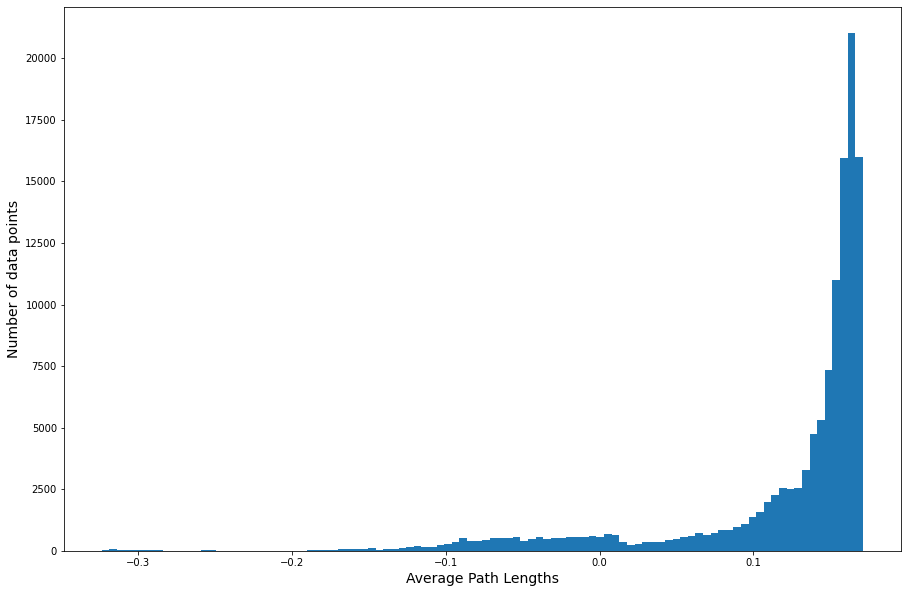

In [162]:
isolation_forest = IsolationForest(n_estimators=100, max_samples=256, contamination=0.1, random_state=42);
isolation_forest.fit(x_train)

anomaly_scores = isolation_forest.decision_function(x_val)
plt.figure(figsize=(15,10))
plt.hist(anomaly_scores, bins=100)
plt.xlabel('Average Path Lengths', fontsize=14)
plt.ylabel('Number of data points', fontsize=14)
plt.show()

In [163]:
from sklearn.metrics import roc_auc_score

anomalies = anomaly_scores > -0.19
matches = y_val == list(encoded.classes_).index("normal.")
auc = roc_auc_score(anomalies, matches)
print ("AUC: {:.2%}".format(auc))

AUC: 97.86%


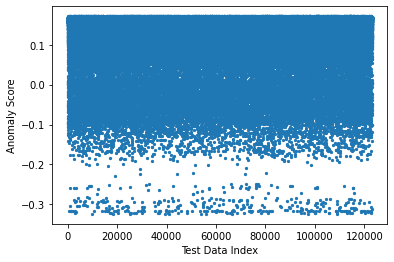

duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate                      1.00
srv_rerror_r

In [164]:
plt.ylabel('Anomaly Score')
plt.xlabel('Test Data Index')
plt.scatter(list(range(len(anomaly_scores))), anomaly_scores, s=5)

plt.show()

prediction = isolation_forest.predict(x_val)
#anomaly_data = [x_val[i] for i in range(len(x_val)) if prediction[i]==-1]
for i in range(len(x_val)):
    if prediction[i]==-1:
        print(x_val.iloc[i])

#print("%s  Anomalous records found out of a total %s" % (len(anomaly_data), len(x_train)))